# 0. 패키지 불러오기 & 데이터 불러오기

In [ ]:
import folium
from folium import plugins
import json
import pandas as pd
import numpy as np
import geopandas as gpd
import fiona
import os
from pandas.io.json import json_normalize
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
from shapely import wkt 
from shapely.geometry import Polygon, LineString, Point
from IPython.display import Image
from tqdm import tqdm

/opt/app-root/lib/python3.6/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


In [ ]:
import warnings 
warnings.filterwarnings(action='ignore')

In [ ]:
# 데이터 불러오기 (소음센서 관련)

df1= pd.read_csv('1.서울시_S-DoT_설치현황자료.csv')
df2= pd.read_csv('2.서울시_S-DoT_측정자료.csv')

df3= pd.read_csv('3.서울시_TOPIS지점별교통량.csv')
df4= pd.read_csv('4.서울시_TOPIS교통량측정지점.csv')

df8= pd.read_csv('8.서울시_버스정류소_공간정보.csv')

df10= gpd.read_file("10.서울시_지하철역_공간정보.geojson")

df11= pd.read_csv('11.서울시_지하철역별_승하차이력.csv')

df13=gpd.read_file("13.서울시_법정경계(시군구).geojson") 
df14=gpd.read_file("14.서울시_법정경계(읍면동).geojson") 

df16= gpd.read_file("16.서울시_인구정보(총인구).geojson")
df17= gpd.read_file("17.서울시_인구정보(고령).geojson")
df18= gpd.read_file("18.서울시_인구정보(생산가능).geojson")
df19= gpd.read_file("19.서울시_인구정보(유소년).geojson")

df31= pd.read_csv( '31.서울시_평일_추정교통량(2018)_1.csv')
df32= pd.read_csv( '32.서울시_평일_추정교통량(2018)_2.csv')
df33= pd.read_csv('33.서울시_평일_일별_혼잡빈도강도(2018).csv')
df34= pd.read_csv('34.서울시_평일_일별_혼잡시간강도(2018).csv')

In [ ]:
# # 데이터 불러오기 (기본 EDA 사용)
df7= pd.read_csv( '7.서울시_미세먼지_발생사업장정보.csv')
df12= pd.read_csv( '12.서울시_CCTV_설치현황.csv')
df27= pd.read_csv('27.서울시_주요공원현황.csv')
df37= pd.read_csv( '37.지자체_미세먼지_간이측정기현황.csv')
df38= pd.read_csv( '38.지자체_미세먼지_측정이력.csv')

In [ ]:
# 데이터 불러오기 (오존센서 관련)
df5= pd.read_csv('5.서울시_일별평균_대기오염도이력.csv')
df6= pd.read_csv('6.서울시_대기오염도_측정지점.csv')

# 1.1 소음센서(S-dot) EDA

In [ ]:
# 전체센서(S-dot) 위치 찍기

center = [37.541, 126.986] #서울 중심
m1= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')
style1 = {'fillColor': False, 'color': '#475974'}
style2 = {'fillColor': '#ED9253', 'color': '#ED9253'}
folium.GeoJson(data=df13["geometry"], style_function=lambda x:style1).add_to(m1)

for i in range(len(df1)):
    folium.Circle(
        location=[df1.iloc[i]['lat'], df1.iloc[i]['lon']],
        radius = 30,
        color = '#000000',
        fill = 'crimson',
    ).add_to(m1)
m1

=> 확인 결과 이상치가 4개 있다. 이 곳은 '서울대공원' 내의 S-DoT로 서울 외부에 있으나 관리를 서울시에서 진행하는 것으로 확인되었다.

In [ ]:
# 1) 소음측정 센서 확인
df1_noise=df1[df1['cen_noise']=='O']
df1_noise

,center_nm,serial,loc_height,lat,lon,cen_pm10,cen_pm25,cen_temp,cen_hu,cen_noise,...,cen_sl_temp,CO,NO2,SO2,NH3,H2S,OZONE,fl_pop_WIFI,fl_pop_VIDEO,note
0,서울대공원,A010,3.5,37.428772,127.016074,O,O,O,O,O,...,O,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN
1,서울대공원,A011,4,37.422013,127.024266,O,O,O,O,O,...,O,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN
2,광진구,A012,4,37.544002,127.069731,O,O,O,O,O,...,O,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN
3,종로구,A013,3,37.583469,126.982622,O,O,O,O,O,...,O,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN
4,중구,A014,3.3,37.563574,126.984504,O,O,O,O,O,...,O,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1055,양천구,B0951,4,37.531246,126.836128,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,O,NaN,NaN
1056,동작구,B0952,4,37.488709,126.978633,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,O,NaN,NaN
1057,강남구,B0953,4.4,37.489030,127.067883,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,O,NaN,NaN
1058,강남구,B0954,3.7,37.508671,127.022791,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,O,NaN,NaN


=> 1064개의 센서중 1059개의 센서에서 소음 측정 가능하다.

In [ ]:
# 2) 소음측정 불가 센서 확인
df1_not_noise=df1[df1['cen_noise']!='O']
df1_not_noise

,center_nm,serial,loc_height,lat,lon,cen_pm10,cen_pm25,cen_temp,cen_hu,cen_noise,...,cen_sl_temp,CO,NO2,SO2,NH3,H2S,OZONE,fl_pop_WIFI,fl_pop_VIDEO,note
1044,중구,B0935,-,37.564800,126.975981,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1060,관악구,B1000,-,37.487167,126.925930,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1061,마포구,B1006,-,37.555257,126.904267,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1062,양천구,B1013,-,37.524531,126.855007,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1063,성동구,B1015,-,37.542039,127.049685,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


=> 1064개의 센서중 5개의 센서에서 소음 측정 불가하다. 소음측정이 불가한 센서는 B0935,B1000, B1006, B1013, B1015 이다.

In [ ]:
# 소음측정 가능 센서 & 소음측정 불가 센서 시각화

center = [37.541, 126.986] #서울 중심
m2= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')
style1 = {'fillColor': False, 'color': '#475974'}
style2 = {'fillColor': '#ED9253', 'color': '#ED9253'}
folium.GeoJson(data=df13["geometry"], style_function=lambda x:style1).add_to(m2)

for i in range(len(df1_noise)):
    folium.Circle(
        location=[df1_noise.iloc[i]['lat'], df1_noise.iloc[i]['lon']],
        radius = 30,
        color = 'blue',
        fill = 'crimson',
    ).add_to(m2)

for i in range(len(df1_not_noise)):
    folium.Circle(
        location=[df1_not_noise.iloc[i]['lat'], df1_not_noise.iloc[i]['lon']],
        radius = 30,
        color = 'red',
        fill = 'crimson',
    ).add_to(m2)
    
m2

###### 소음센서
대부분의 센서 (S-dot) 가 소음 측정이 가능하고, 소음 측정이 불가한 센서들끼리 특별한 특징 및 관련이 없는 것을 알 수 있다.

###### 오존센서
전체 센서중 오존 측정이 가능한 센서는 없다. 즉, 오존 측정 센서는 완전히 새롭게 달아야 한다.

In [ ]:
# 센서별 소음값 평균 DF 만들기
merge_df1 = pd.merge(df2, df1,on='serial',how='left')

In [ ]:
group1=merge_df1.groupby(merge_df1['serial']).mean()
group1=group1[['cen_noise_x','lat','lon']].dropna(axis=0)

# 소음 측정 불가한 센서는 제거
drop_index2=group1[group1['cen_noise_x']==0].index
group1=group1.drop(drop_index2)
group1

,cen_noise_x,lat,lon
serial,,,
A010,50.577627,37.428772,127.016074
A011,49.170358,37.422013,127.024266
A012,57.427961,37.544002,127.069731
A013,49.218206,37.583469,126.982622
A014,58.572176,37.563574,126.984504
...,...,...,...
B0951,46.366970,37.531246,126.836129
B0952,48.792390,37.488709,126.978633
B0953,48.217855,37.489030,127.067883


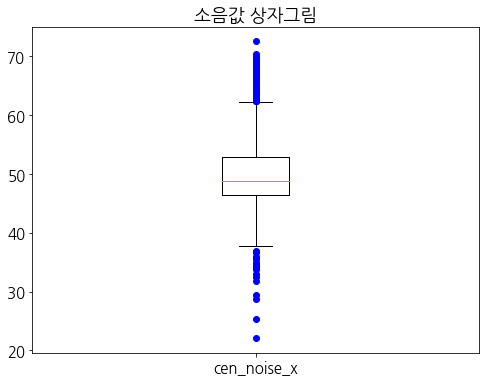

In [ ]:
# boxplot 으로 값 분포보기

plt.rcParams['figure.figsize'] = [8,6]
plt.rcParams['font.family'] = 'NanumGothic'
plt.rcParams['font.size'] = 15
plt.boxplot(group1['cen_noise_x'], sym="bo")
plt.title('소음값 상자그림')
plt.xticks([1], ['cen_noise_x'])
plt.show()

In [ ]:
print("평균: ",group1['cen_noise_x'].mean(),"\n중앙값:",group1['cen_noise_x'].median(),"\n최소값:",group1['cen_noise_x'].min(),"\n최대값:",group1['cen_noise_x'].max())

평균:  50.151530564776465 
중앙값: 48.83812996483917 
최소값: 22.122559920929085 
최대값: 72.53977798334876


센서별 소음값의 평균은 50.14563557670925, 중앙값은 48.82723483094025 최소값은 22.122559920929085, 최대값은 72.53977798334876이다.


데이터가 비교적 넓게 퍼져있는 것이 확인된다.

###### 다음으로, 소음값별로 구분해서 센서 위치를 구분하였다.

소음 기준은 70dB이상 : 소음 , 100dB 심한 소음이며 마커 색으로 구분하였다.

In [ ]:
# 소음센서 값별로 구분해서 시각화

lat = group1['lat']
lon = group1['lon']
center = [37.541, 126.986] #서울 중심

m3= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')
style1 = {'fillColor': False, 'color': '#475974'}
style2 = {'fillColor': '#ED9253', 'color': '#ED9253'}
folium.GeoJson(data=df13["geometry"], style_function=lambda x:style1).add_to(m3)

for i in range(len(group1)):
    if group1['cen_noise_x'][i]>=100:
        color = 'red'
    elif group1['cen_noise_x'][i]>=70:
        color='orange'
    else:
        color='blue'
        
    location=(lat[i], lon[i])
    folium.Marker(location, popup=group1['cen_noise_x'][i], icon=folium.Icon(color = color)).add_to(m3)
    
m3

결과적으로 소음이 70dB가 넘는 (약한 소음,전화벨 및 시끄러운 사무실 정도 ) 경우는 2개 밖에 없으며, 나머지는 모두 70dB 이하인 것으로 확인되었다.

###### 이번에는 소음 기준을 바꿔보았다.

국가소음정보시스템에 나온대로 소음 기준을 분리하였다. (이미지 삽입)

In [ ]:
# 소음센서 값별로 구분해서 시각화(2)

lat = group1['lat']
lon = group1['lon']

center = [37.541, 126.986] #서울 중심
m4= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')
style1 = {'fillColor': False, 'color': '#475974'}
style2 = {'fillColor': '#ED9253', 'color': '#ED9253'}
folium.GeoJson(data=df13["geometry"], style_function=lambda x:style1).add_to(m4)

for i in range(len(group1)):
    if group1['cen_noise_x'][i]>70:
        color = 'red'
    elif group1['cen_noise_x'][i]>65:
        color='orange'
    elif group1['cen_noise_x'][i]>60:
        color='beige' #노란색이 없어서 대체
    elif group1['cen_noise_x'][i]>55:
        color='green'
    elif group1['cen_noise_x'][i]>50:
        color='blue'
    else:
        color='darkblue'
        
    location=(lat[i], lon[i])
    folium.Marker(location, popup=group1['cen_noise_x'][i], icon=folium.Icon(color = color)).add_to(m4)
m4

# 2.1 100X100 격자별 데이터 합치기

mclp 알고리즘을 사용해서 프로젝트를 진행할 예정이다. 따라서 격자별로 데이터 (df16~19)을 합쳤다.

In [ ]:
# 0.격자별 데이터 (16~19 합치기)

df16 = df16.rename(columns = {"val":"val_total"})
df17 = df17.rename(columns = {"val":"val_senior"})
df18 = df18.rename(columns = {"val":"val_work"})
df19 = df19.rename(columns = {"val":"val_junior"})

In [ ]:
# DF16~19 합치기

df_pop=pd.merge(pd.merge(pd.merge(
    df16[['gid','geometry','val_total']], df17[['gid', 'val_senior']]),
                                   df18[['gid','val_work']]),
                          df19[['gid','val_junior']])


# 격자 내 center_point col 추가

center_points = []

for i in tqdm(range(len(df_pop))):
    center_point = wkt.loads(str(df_pop['geometry'].iloc[i])).centroid
    
    center_points.append(center_point)
    
if len(center_points) == len(df_pop):
    df_pop['center_point'] = center_points

    
# gird_id 추가하기
df_pop['grid_id']=0 
idx = []
for i in range(len(df_pop)):
    idx.append(str(i).zfill(5))
df_pop['grid_id'] = pd.DataFrame(idx)

df_pop['val_total'] = df_pop['val_total'].fillna(0)
df_pop['val_senior'] = df_pop['val_senior'].fillna(0)
df_pop['val_work'] = df_pop['val_work'].fillna(0)
df_pop['val_junior'] = df_pop['val_junior'].fillna(0)
df_pop[df_pop['val_total']!=0]


100%|██████████| 61649/61649 [00:16<00:00, 3740.76it/s]


,gid,geometry,val_total,val_senior,val_work,val_junior,center_point,grid_id
894,다사380537,"MULTIPOLYGON (((126.79781 37.58060, 126.79780 ...",14.0,0.0,10.0,0.0,POINT (126.7983748797448 37.58105337136812),00894
895,다사380538,"MULTIPOLYGON (((126.79780 37.58150, 126.79780 ...",27.0,8.0,18.0,0.0,POINT (126.7983664212195 37.58195465780685),00895
896,다사380539,"MULTIPOLYGON (((126.79780 37.58240, 126.79779 ...",7.0,0.0,0.0,0.0,POINT (126.7983579623175 37.58285594410591),00896
897,다사380540,"MULTIPOLYGON (((126.79779 37.58330, 126.79778 ...",13.0,0.0,9.0,0.0,POINT (126.7983495030383 37.58375723026546),00897
898,다사380541,"MULTIPOLYGON (((126.79778 37.58420, 126.79777 ...",14.0,0.0,10.0,0.0,POINT (126.7983410433823 37.58465851628538),00898
...,...,...,...,...,...,...,...,...
61610,다사717516,"MULTIPOLYGON (((127.17956 37.56332, 127.17955 ...",232.0,75.0,148.0,9.0,POINT (127.1801221480042 37.56377677346293),61610
61627,다사718511,"MULTIPOLYGON (((127.18071 37.55882, 127.18071 ...",297.0,44.0,217.0,36.0,POINT (127.1812736421267 37.55927311950178),61627
61628,다사718512,"MULTIPOLYGON (((127.18071 37.55972, 127.18070 ...",441.0,50.0,299.0,92.0,POINT (127.1812698026239 37.56017446305238),61628
61629,다사718513,"MULTIPOLYGON (((127.18070 37.56062, 127.18070 ...",424.0,63.0,299.0,62.0,POINT (127.1812659629501 37.56107580646471),61629


# 2.2 시군구별 데이터 합치기

현재 대부분의 데이터가 위경도 혹은 100x100 격자 기준으로 구성된 상황이다.


하지만 현재 센서가 시군구별로 골고루 설치되었는지 알기 위해 데이터를 시군구 기준으로 정제해준다.

###### 사용한데이터 : 격자별 인구수, 노인인구수, 생산가능인구수, 어린이인구수 (df16~19) / 공원데이터 (df7) / 미세먼지사업장데이터 (df7)


참고) 원래는 df14 (읍면동 기준) 를 사용할 예정이었으나 손이 아파 df13 (시군구 기준)을 사용하였다.


In [ ]:
# 시군구별로 구분 (MULTIPOLYGON-> POLYGON으로 변경)

df13=gpd.read_file("13.서울시_법정경계(시군구).geojson") 
df13

umd_polys = {}

multi_polys = list(df13['geometry'])

for i in tqdm(range(len(multi_polys))):
    polys = []
    if multi_polys[i].geom_type == "MultiPolygon":
        for poly in multi_polys[i]:
            polys.append(poly)
    umd_polys[df13['SIG_KOR_NM'].iloc[i]] = polys
    
umd_polys

100%|██████████| 25/25 [00:00<00:00, 14110.83it/s]


{'종로구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044ac8>],
 '중구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044b00>],
 '용산구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044c50>],
 '성동구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044cc0>],
 '광진구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044d30>],
 '동대문구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044da0>],
 '중랑구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044ef0>],
 '성북구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044f60>],
 '강북구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3044fd0>],
 '도봉구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3040080>],
 '노원구': [<shapely.geometry.polygon.Polygon at 0x7fa5a30400f0>],
 '은평구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3040160>],
 '서대문구': [<shapely.geometry.polygon.Polygon at 0x7fa5a30401d0>],
 '마포구': [<shapely.geometry.polygon.Polygon at 0x7fa5a3040240>],
 '양천구': [<shapely.geometry.polygon.Polygon at 0x7fa5a30402b0>],
 '강서구': [<shapely.geometry.polygon.Poly

In [ ]:
umd_dict = {"종로구": [], "중구": [], "용산구": [], "성동구": [], "광진구": [], 
            "동대문구": [], "중랑구": [], "성북구": [], "강북구": [], "도봉구": [], 
            "노원구": [], "은평구": [], "서대문구": [], "마포구": [], "양천구": [], 
            "강서구": [],"구로구": [], "금천구": [], "영등포구": [],"동작구": [],
            "관악구": [],"서초구": [],"강남구": [],"송파구": [],"강동구": []}

umd_key  = list(umd_polys.keys())

for c in tqdm(range(len(list(df_pop['geometry'])))):
    
    for i, key in enumerate(umd_key):
        umd_poly = umd_polys[key]
        for poly in umd_poly:
            if poly.contains(df_pop['geometry'].iloc[c]):
                umd_dict[df13['SIG_KOR_NM'].iloc[i]].append(df_pop['grid_id'].iloc[c])

100%|██████████| 61649/61649 [04:17<00:00, 239.65it/s]


In [ ]:
# 1) 시군구별 전체 인구수 (df16)

umd_sensor_infos_total = {}

keys = list(umd_dict.keys())

for key in keys:
    umd_ids = umd_dict[key]

    total = 0

    for i in tqdm(range(len(umd_ids))):
        temp_gdf = df_pop[df_pop['grid_id'] == umd_ids[i]]
        
        total = total + temp_gdf['val_total'].iloc[0]

    umd_sensor_infos_total[key] = total
    
umd_sensor_infos_total


100%|██████████| 2299/2299 [00:13<00:00, 166.17it/s]


{'종로구': 140488.0,
 '중구': 110685.0,
 '용산구': 219247.0,
 '성동구': 276335.0,
 '광진구': 339836.0,
 '동대문구': 332401.0,
 '중랑구': 391650.0,
 '성북구': 415695.0,
 '강북구': 296281.0,
 '도봉구': 316467.0,
 '노원구': 516002.0,
 '은평구': 470837.0,
 '서대문구': 301273.0,
 '마포구': 356858.0,
 '양천구': 438788.0,
 '강서구': 568555.0,
 '구로구': 385488.0,
 '금천구': 224547.0,
 '영등포구': 367076.0,
 '동작구': 374036.0,
 '관악구': 478030.0,
 '서초구': 415250.0,
 '강남구': 535670.0,
 '송파구': 661643.0,
 '강동구': 452660.0}

In [ ]:
# 2) 시군구별 노인 인구수 (df17)

umd_sensor_infos_senior = {}

keys = list(umd_dict.keys())

for key in keys:
    umd_ids = umd_dict[key]

    total = 0

    for i in tqdm(range(len(umd_ids))):
        temp_gdf = df_pop[df_pop['grid_id'] == umd_ids[i]]
        
        total = total + temp_gdf['val_senior'].iloc[0]

    umd_sensor_infos_senior[key] = total

umd_sensor_infos_senior

100%|██████████| 2299/2299 [00:14<00:00, 154.15it/s]


{'종로구': 28360.0,
 '중구': 23096.0,
 '용산구': 40267.0,
 '성동구': 46455.0,
 '광진구': 53658.0,
 '동대문구': 64918.0,
 '중랑구': 74806.0,
 '성북구': 75844.0,
 '강북구': 65486.0,
 '도봉구': 65049.0,
 '노원구': 91190.0,
 '은평구': 89479.0,
 '서대문구': 55941.0,
 '마포구': 55551.0,
 '양천구': 68879.0,
 '강서구': 94502.0,
 '구로구': 71643.0,
 '금천구': 41010.0,
 '영등포구': 63920.0,
 '동작구': 67455.0,
 '관악구': 81073.0,
 '서초구': 63122.0,
 '강남구': 80046.0,
 '송파구': 100764.0,
 '강동구': 74984.0}

In [ ]:
# 3) 시군구별 전체 생산가능인구수 (df18)

umd_sensor_infos_work = {}

keys = list(umd_dict.keys())

for key in keys:
    umd_ids = umd_dict[key]

    total = 0

    for i in tqdm(range(len(umd_ids))):
        temp_gdf = df_pop[df_pop['grid_id'] == umd_ids[i]]
        
        total = total + temp_gdf['val_work'].iloc[0]

    umd_sensor_infos_work[key] = total
    
umd_sensor_infos_work

100%|██████████| 2299/2299 [00:14<00:00, 158.11it/s]


{'종로구': 100694.0,
 '중구': 79026.0,
 '용산구': 160187.0,
 '성동구': 203758.0,
 '광진구': 257175.0,
 '동대문구': 238490.0,
 '중랑구': 284158.0,
 '성북구': 299341.0,
 '강북구': 207867.0,
 '도봉구': 223912.0,
 '노원구': 373226.0,
 '은평구': 337841.0,
 '서대문구': 217087.0,
 '마포구': 266425.0,
 '양천구': 320483.0,
 '강서구': 418140.0,
 '구로구': 275558.0,
 '금천구': 165752.0,
 '영등포구': 269465.0,
 '동작구': 273510.0,
 '관악구': 365754.0,
 '서초구': 300313.0,
 '강남구': 395761.0,
 '송파구': 488009.0,
 '강동구': 328154.0}

In [ ]:
# 4) 시군구별 어린이 인구수 (df19)

umd_sensor_infos_junior = {}

keys = list(umd_dict.keys())

for key in keys:
    umd_ids = umd_dict[key]

    total = 0

    for i in tqdm(range(len(umd_ids))):
        temp_gdf = df_pop[df_pop['grid_id'] == umd_ids[i]]
        
        total = total + temp_gdf['val_junior'].iloc[0]

    umd_sensor_infos_junior[key] = total
    
umd_sensor_infos_junior

100%|██████████| 2299/2299 [00:15<00:00, 146.80it/s]


{'종로구': 9710.0,
 '중구': 7841.0,
 '용산구': 17829.0,
 '성동구': 25526.0,
 '광진구': 28492.0,
 '동대문구': 28158.0,
 '중랑구': 32221.0,
 '성북구': 39260.0,
 '강북구': 22368.0,
 '도봉구': 27014.0,
 '노원구': 50922.0,
 '은평구': 42898.0,
 '서대문구': 27404.0,
 '마포구': 34035.0,
 '양천구': 49123.0,
 '강서구': 55123.0,
 '구로구': 37645.0,
 '금천구': 17384.0,
 '영등포구': 32800.0,
 '동작구': 32519.0,
 '관악구': 30536.0,
 '서초구': 50374.0,
 '강남구': 58063.0,
 '송파구': 72218.0,
 '강동구': 48995.0}

다음으로 S-dot 위경도 데이터 (df1)을 기준으로 잡고 각 센서의 시군구 위치를 나타내준다.

In [ ]:
# 1) 시군구에 s-Dot 몇개 설치되었는지 보기

point_dict = {}

for i in range(len(df1)):
    point_dict[df1['serial'].iloc[i]] = {}
    
    point_dict[df1['serial'].iloc[i]]['Point'] = Point(df1['lon'].iloc[i], df1['lat'].iloc[i])
    
point_dict

{'A012': {'Point': <shapely.geometry.point.Point at 0x7f463c27a518>},
 'A013': {'Point': <shapely.geometry.point.Point at 0x7f463c27af28>},
 'A014': {'Point': <shapely.geometry.point.Point at 0x7f463c27a780>},
 'A015': {'Point': <shapely.geometry.point.Point at 0x7f463c27af60>},
 'A016': {'Point': <shapely.geometry.point.Point at 0x7f463c27a978>},
 'A017': {'Point': <shapely.geometry.point.Point at 0x7f463c27a1d0>},
 'A018': {'Point': <shapely.geometry.point.Point at 0x7f463c27ad68>},
 'A019': {'Point': <shapely.geometry.point.Point at 0x7f463c27a898>},
 'A020': {'Point': <shapely.geometry.point.Point at 0x7f463c27a8d0>},
 'A021': {'Point': <shapely.geometry.point.Point at 0x7f463c27a6d8>},
 'A022': {'Point': <shapely.geometry.point.Point at 0x7f463c27a7b8>},
 'A023': {'Point': <shapely.geometry.point.Point at 0x7f463c83e048>},
 'A024': {'Point': <shapely.geometry.point.Point at 0x7f463c83e080>},
 'A025': {'Point': <shapely.geometry.point.Point at 0x7f463c83e0b8>},
 'A026': {'Point': <

In [ ]:
point_dict_keys = list(point_dict.keys())
umd_keys = list(umd_polys.keys())

for key in point_dict_keys:
    for umd_key in umd_keys:
        umd_ploy_lists = umd_polys[umd_key]

        for umd_polygon in umd_ploy_lists:
            if umd_polygon.contains(point_dict[key]['Point']) == True:
                point_dict[key]['umd'] = umd_key
                break
point_dict

{'A012': {'Point': <shapely.geometry.point.Point at 0x7f463c27a518>,
  'umd': '광진구'},
 'A013': {'Point': <shapely.geometry.point.Point at 0x7f463c27af28>,
  'umd': '종로구'},
 'A014': {'Point': <shapely.geometry.point.Point at 0x7f463c27a780>,
  'umd': '중구'},
 'A015': {'Point': <shapely.geometry.point.Point at 0x7f463c27af60>,
  'umd': '강남구'},
 'A016': {'Point': <shapely.geometry.point.Point at 0x7f463c27a978>,
  'umd': '강남구'},
 'A017': {'Point': <shapely.geometry.point.Point at 0x7f463c27a1d0>,
  'umd': '강동구'},
 'A018': {'Point': <shapely.geometry.point.Point at 0x7f463c27ad68>,
  'umd': '성동구'},
 'A019': {'Point': <shapely.geometry.point.Point at 0x7f463c27a898>,
  'umd': '용산구'},
 'A020': {'Point': <shapely.geometry.point.Point at 0x7f463c27a8d0>,
  'umd': '강남구'},
 'A021': {'Point': <shapely.geometry.point.Point at 0x7f463c27a6d8>,
  'umd': '강남구'},
 'A022': {'Point': <shapely.geometry.point.Point at 0x7f463c27a7b8>,
  'umd': '강남구'},
 'A023': {'Point': <shapely.geometry.point.Point at 0x7

In [ ]:
# df1에 시군구 col 추가
st_names = list(df1['serial'])
umd_infos = []

for st_name in tqdm(st_names):
    try:
        umd_name = point_dict[st_name]['umd']
        umd_infos.append(umd_name)
    except Exception as E:
        umd_name = None
        print(st_name)
        print(f"Error Message : {E}")
        umd_infos.append(umd_name)
df1['시군구(법정경계)'] = umd_infos

df1

100%|██████████| 1060/1060 [00:00<00:00, 944342.02it/s]


,center_nm,serial,loc_height,lat,lon,cen_pm10,cen_pm25,cen_temp,cen_hu,cen_noise,...,CO,NO2,SO2,NH3,H2S,OZONE,fl_pop_WIFI,fl_pop_VIDEO,note,시군구(법정경계)
2,광진구,A012,4,37.544002,127.069731,O,O,O,O,O,...,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN,광진구
3,종로구,A013,3,37.583469,126.982622,O,O,O,O,O,...,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN,종로구
4,중구,A014,3.3,37.563574,126.984504,O,O,O,O,O,...,NaN,NaN,NaN,O,O,NaN,NaN,O,NaN,중구
5,강남구,A015,3.4,37.523384,127.022415,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,O,NaN,강남구
6,강남구,A016,3.8,37.525889,127.039126,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,O,NaN,강남구
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1059,서초구,B0955,5.7,37.504581,126.994501,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,대기측정소 비교,서초구
1060,관악구,B1000,-,37.487167,126.925930,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,관악구
1061,마포구,B1006,-,37.555257,126.904267,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,마포구
1062,양천구,B1013,-,37.524531,126.855007,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,양천구


In [ ]:
# 1. 시군구별 총인구수 df1에 합치기 (시군구 기준)
sensor_st_umd_list = list(df1['시군구(법정경계)'])

sensor_enroll_infos = []

for umd in sensor_st_umd_list:
    sensor_enroll_info = umd_sensor_infos_total[umd]
    
    sensor_enroll_infos.append(sensor_enroll_info)
    
df1['시군구_총인구'] = sensor_enroll_infos
df1

In [ ]:
# 2. 시군구별 노인인구수 df1에 합치기 (시군구 기준)
sensor_st_umd_list = list(df1['시군구(법정경계)'])

sensor_enroll_infos = []

for umd in sensor_st_umd_list:
    sensor_enroll_info = umd_sensor_infos_senior[umd]
    
    sensor_enroll_infos.append(sensor_enroll_info)
    
df1['시군구_노약자'] = sensor_enroll_infos
df1

,center_nm,serial,loc_height,lat,lon,cen_pm10,cen_pm25,cen_temp,cen_hu,cen_noise,...,SO2,NH3,H2S,OZONE,fl_pop_WIFI,fl_pop_VIDEO,note,시군구(법정경계),시군구_총인구,시군구_노약자
2,광진구,A012,4,37.544002,127.069731,O,O,O,O,O,...,NaN,O,O,NaN,NaN,O,NaN,광진구,339836.0,53658.0
3,종로구,A013,3,37.583469,126.982622,O,O,O,O,O,...,NaN,O,O,NaN,NaN,O,NaN,종로구,140488.0,28360.0
4,중구,A014,3.3,37.563574,126.984504,O,O,O,O,O,...,NaN,O,O,NaN,NaN,O,NaN,중구,110685.0,23096.0
5,강남구,A015,3.4,37.523384,127.022415,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,O,NaN,강남구,535670.0,80046.0
6,강남구,A016,3.8,37.525889,127.039126,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,O,NaN,강남구,535670.0,80046.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1059,서초구,B0955,5.7,37.504581,126.994501,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,NaN,대기측정소 비교,서초구,415250.0,63122.0
1060,관악구,B1000,-,37.487167,126.925930,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,관악구,478030.0,81073.0
1061,마포구,B1006,-,37.555257,126.904267,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,마포구,356858.0,55551.0
1062,양천구,B1013,-,37.524531,126.855007,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,양천구,438788.0,68879.0


In [ ]:
# 3. 시군구별 생산가능인구 df1에 합치기 (시군구 기준)

sensor_st_umd_list = list(df1['시군구(법정경계)'])

sensor_enroll_infos = []

for umd in sensor_st_umd_list:
    sensor_enroll_info = umd_sensor_infos_work[umd]
    
    sensor_enroll_infos.append(sensor_enroll_info)
    
df1['시군구_생산가능인구'] = sensor_enroll_infos
df1

,center_nm,serial,loc_height,lat,lon,cen_pm10,cen_pm25,cen_temp,cen_hu,cen_noise,...,NH3,H2S,OZONE,fl_pop_WIFI,fl_pop_VIDEO,note,시군구(법정경계),시군구_총인구,시군구_노약자,시군구_생산가능인구
2,광진구,A012,4,37.544002,127.069731,O,O,O,O,O,...,O,O,NaN,NaN,O,NaN,광진구,339836.0,53658.0,257175.0
3,종로구,A013,3,37.583469,126.982622,O,O,O,O,O,...,O,O,NaN,NaN,O,NaN,종로구,140488.0,28360.0,100694.0
4,중구,A014,3.3,37.563574,126.984504,O,O,O,O,O,...,O,O,NaN,NaN,O,NaN,중구,110685.0,23096.0,79026.0
5,강남구,A015,3.4,37.523384,127.022415,O,O,O,O,O,...,NaN,NaN,NaN,NaN,O,NaN,강남구,535670.0,80046.0,395761.0
6,강남구,A016,3.8,37.525889,127.039126,O,O,O,O,O,...,NaN,NaN,NaN,NaN,O,NaN,강남구,535670.0,80046.0,395761.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1059,서초구,B0955,5.7,37.504581,126.994501,O,O,O,O,O,...,NaN,NaN,NaN,NaN,NaN,대기측정소 비교,서초구,415250.0,63122.0,300313.0
1060,관악구,B1000,-,37.487167,126.925930,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,관악구,478030.0,81073.0,365754.0
1061,마포구,B1006,-,37.555257,126.904267,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,마포구,356858.0,55551.0,266425.0
1062,양천구,B1013,-,37.524531,126.855007,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,양천구,438788.0,68879.0,320483.0


In [ ]:
# 4. 시군구별 어린이인구수 df1에 합치기 (시군구 기준)

sensor_st_umd_list = list(df1['시군구(법정경계)'])

sensor_enroll_infos = []

for umd in sensor_st_umd_list:
    sensor_enroll_info = umd_sensor_infos_junior[umd]
    
    sensor_enroll_infos.append(sensor_enroll_info)
    
df1['시군구_어린이'] = sensor_enroll_infos
df1

,center_nm,serial,loc_height,lat,lon,cen_pm10,cen_pm25,cen_temp,cen_hu,cen_noise,...,H2S,OZONE,fl_pop_WIFI,fl_pop_VIDEO,note,시군구(법정경계),시군구_총인구,시군구_노약자,시군구_생산가능인구,시군구_어린이
2,광진구,A012,4,37.544002,127.069731,O,O,O,O,O,...,O,NaN,NaN,O,NaN,광진구,339836.0,53658.0,257175.0,28492.0
3,종로구,A013,3,37.583469,126.982622,O,O,O,O,O,...,O,NaN,NaN,O,NaN,종로구,140488.0,28360.0,100694.0,9710.0
4,중구,A014,3.3,37.563574,126.984504,O,O,O,O,O,...,O,NaN,NaN,O,NaN,중구,110685.0,23096.0,79026.0,7841.0
5,강남구,A015,3.4,37.523384,127.022415,O,O,O,O,O,...,NaN,NaN,NaN,O,NaN,강남구,535670.0,80046.0,395761.0,58063.0
6,강남구,A016,3.8,37.525889,127.039126,O,O,O,O,O,...,NaN,NaN,NaN,O,NaN,강남구,535670.0,80046.0,395761.0,58063.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1059,서초구,B0955,5.7,37.504581,126.994501,O,O,O,O,O,...,NaN,NaN,NaN,NaN,대기측정소 비교,서초구,415250.0,63122.0,300313.0,50374.0
1060,관악구,B1000,-,37.487167,126.925930,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,관악구,478030.0,81073.0,365754.0,30536.0
1061,마포구,B1006,-,37.555257,126.904267,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,마포구,356858.0,55551.0,266425.0,34035.0
1062,양천구,B1013,-,37.524531,126.855007,O,O,O,O,NaN,...,NaN,NaN,NaN,NaN,NaN,양천구,438788.0,68879.0,320483.0,49123.0


In [ ]:
# 5. 시군구별 S-dot 수 구하기

umd_sensor_info_dict = {}

for umd_key in umd_keys:
    umd_sensor_info_dict[umd_key] = {}
    umd_sensor_info_dict[umd_key]['serial'] = []
    umd_sensor_info_dict[umd_key]['S-dot 개수']=0
    
    
for i in range(len(df1)):
    umd = df1['시군구(법정경계)'].iloc[i]   
    umd_sensor_info_dict[umd]['serial'].append(df1['serial'].iloc[i])
    umd_sensor_info_dict[umd]['S-dot 개수']+= 1
    
umd_sensor_info_dict

{'종로구': {'serial': ['A013',
   'A037',
   'A038',
   'A039',
   'A040',
   'A153',
   'A154',
   'A194',
   'A201',
   'A210',
   'A211',
   'A219',
   'A220',
   'B0232',
   'B0499',
   'B0522',
   'B0539',
   'B0649',
   'B0655',
   'B0687',
   'B0695',
   'B0710',
   'B0716',
   'B0718',
   'B0719',
   'B0720',
   'B0721',
   'B0737',
   'B0796',
   'B0797',
   'B0802',
   'B0807',
   'B0808',
   'B0810',
   'B0817',
   'B0818',
   'B0822',
   'B0827',
   'B0837',
   'B0839',
   'B0840',
   'B0841',
   'B0843',
   'B0844',
   'B0848',
   'B0857',
   'B0859',
   'B0875',
   'B0877',
   'B0881',
   'B0883',
   'B0886'],
  'S-dot 개수': 52},
 '중구': {'serial': ['A014',
   'A041',
   'A042',
   'A043',
   'A044',
   'A047',
   'A127',
   'A212',
   'B0053',
   'B0302',
   'B0436',
   'B0438',
   'B0498',
   'B0500',
   'B0508',
   'B0527',
   'B0529',
   'B0536',
   'B0540',
   'B0541',
   'B0544',
   'B0546',
   'B0553',
   'B0554',
   'B0562',
   'B0564',
   'B0566',
   'B0567',
   'B056

In [ ]:
# 시군구 기준으로 df 정리

umd_names = list(umd_sensor_info_dict.keys())
sensor_st_names = []
total_sensor=[]
sensor_enroll_list_total = []
sensor_enroll_list_senior = []
sensor_enroll_list_work = []
sensor_enroll_list_junior = []

for key in umd_names:
    sensor_st_name = " | ".join(umd_sensor_info_dict[key]['serial'])
    
    if sensor_st_name == '':
        sensor_st_name = None
    sensor_st_names.append(sensor_st_name)
    
    total_sensor.append(umd_sensor_info_dict[key]['S-dot 개수'])
    sensor_enroll_list_total.append(umd_sensor_infos_total[key])
    sensor_enroll_list_senior.append(umd_sensor_infos_senior[key])
    sensor_enroll_list_work.append(umd_sensor_infos_work[key])
    sensor_enroll_list_junior.append(umd_sensor_infos_junior[key])
    
umd_infos_df = pd.DataFrame({"시군구":umd_names, "S-dot":sensor_st_names, "S-dot 개수":total_sensor,
                             "총인구":sensor_enroll_list_total, "노인인구":sensor_enroll_list_senior,
                             "생산가능인구":sensor_enroll_list_work, "어린이인구":sensor_enroll_list_junior})
                             
umd_infos_df


,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구
0,종로구,A013 | A037 | A038 | A039 | A040 | A153 | A154...,52,140488.0,28360.0,100694.0,9710.0
1,중구,A014 | A041 | A042 | A043 | A044 | A047 | A127...,40,110685.0,23096.0,79026.0,7841.0
2,용산구,A019 | B0523 | B0524 | B0525 | B0559 | B0571 |...,25,219247.0,40267.0,160187.0,17829.0
3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0
4,광진구,A012 | A029 | A142 | A143 | A190 | B0134 | B02...,29,339836.0,53658.0,257175.0,28492.0
5,동대문구,A195 | A196 | A197 | B0049 | B0058 | B0081 | B...,25,332401.0,64918.0,238490.0,28158.0
6,중랑구,A169 | A202 | A203 | B0159 | B0172 | B0191 | B...,26,391650.0,74806.0,284158.0,32221.0
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0
8,강북구,A066 | A100 | A104 | A129 | A130 | A132 | A133...,32,296281.0,65486.0,207867.0,22368.0
9,도봉구,A030 | A048 | A049 | A050 | A051 | A052 | A053...,44,316467.0,65049.0,223912.0,27014.0


###### 다음으로 시군구별로 공원(df27)이 몇 개 있는지 알아본다.

그런데 df27 데이터에 서울외 지역의 값과 null 값이 있어 이를 수정한다.


null 값은 구글어스를 참고해서 위, 경도를 가져왔다.

In [ ]:
# 공원 데이터 (df27) 정제
df27= pd.read_csv('27.서울시_주요공원현황.csv')

#'서울로7017' 좌표 추가 (null 값 처리). 출처: 구글어스
df27.loc[131, ['lon', 'lat']] = [126.973755431,37.5565067]
df27

,prk_nm,prk_loc,lon,lat
0,남산도시자연공원,중구,126.990377,37.550140
1,길동생태공원,강동구,127.154779,37.540394
3,서울숲,성동구,127.041798,37.543072
4,월드컵공원,마포구,126.878907,37.571805
5,광화문시민열린마당,종로구,126.978023,37.575045
...,...,...,...,...
127,용마도시자연공원(사가정공원),중랑구,127.095997,37.579762
128,문화비축기지,마포구,126.893246,37.571718
129,경춘선숲길,NaN,127.076482,37.627077
130,율현공원,강남구,127.115594,37.472332


In [ ]:
# 공원 point 추가

park_point_dict = {}

for i in range(len(df27)):
    park_point_dict[df27['prk_nm'].iloc[i]] = {}
    
    park_point_dict[df27['prk_nm'].iloc[i]]['Point'] = Point(df27['lon'].iloc[i], df27['lat'].iloc[i])
    
park_point_dict


{'남산도시자연공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3010f28>},
 '길동생태공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3010f60>},
 '서울숲': {'Point': <shapely.geometry.point.Point at 0x7fa5a30109e8>},
 '월드컵공원': {'Point': <shapely.geometry.point.Point at 0x7fa630da9d68>},
 '광화문시민열린마당': {'Point': <shapely.geometry.point.Point at 0x7fa5a3010fd0>},
 '진관근린공원(구파발폭포)': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031048>},
 '중마루근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031080>},
 '응봉공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a30310b8>},
 '매화근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a30310f0>},
 '성수근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031160>},
 '샛마을근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031198>},
 '여의도근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a30311d0>},
 '간데메근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031128>},
 '훈련원근린공원': {'Point': <shapely.geometry.point.Point at

기존 공원 데이터 (df27)의 prk_loc 에 각 공원의 시군구가 나와있다. 

그러나 포털내 주소 검색과 해당 데이터를 비교한 결과 df27의 시군구 분류가 제대로 진행되지 않은 것으로 확인되었다.

따라서 lon, lat col을 활용해서 주소를 재분류한다.

In [ ]:
# 주소 제대로 할당해서 재분류

umds = []
park_point_dict_keys = list(park_point_dict.keys())
umd_keys = list(umd_polys.keys())

for key in park_point_dict_keys:
    for umd_key in umd_keys:
        umd_ploy_lists = umd_polys[umd_key]

        for umd_polygon in umd_ploy_lists:
            if umd_polygon.contains(park_point_dict[key]['Point']) == True:
                park_point_dict[key]['umd'] = umd_key
                umds.append(umd_key)
                break
park_point_dict

{'남산도시자연공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3010f28>,
  'umd': '용산구'},
 '길동생태공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3010f60>,
  'umd': '강동구'},
 '서울숲': {'Point': <shapely.geometry.point.Point at 0x7fa5a30109e8>,
  'umd': '성동구'},
 '월드컵공원': {'Point': <shapely.geometry.point.Point at 0x7fa630da9d68>,
  'umd': '마포구'},
 '광화문시민열린마당': {'Point': <shapely.geometry.point.Point at 0x7fa5a3010fd0>,
  'umd': '종로구'},
 '진관근린공원(구파발폭포)': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031048>,
  'umd': '은평구'},
 '중마루근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031080>,
  'umd': '영등포구'},
 '응봉공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a30310b8>,
  'umd': '성동구'},
 '매화근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a30310f0>,
  'umd': '강서구'},
 '성수근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031160>,
  'umd': '성동구'},
 '샛마을근린공원': {'Point': <shapely.geometry.point.Point at 0x7fa5a3031198>,
  'umd': '강동구'},
 '여의도근린공원': {'Point': <

In [ ]:
# 시군구별 갯수
from collections import Counter

umd_cnt = Counter(umds)

umd_cnt

Counter({'용산구': 3,
         '강동구': 7,
         '성동구': 5,
         '마포구': 5,
         '종로구': 12,
         '은평구': 6,
         '영등포구': 5,
         '강서구': 9,
         '동대문구': 4,
         '중구': 4,
         '동작구': 6,
         '광진구': 2,
         '서대문구': 4,
         '서초구': 5,
         '금천구': 4,
         '성북구': 4,
         '구로구': 4,
         '양천구': 5,
         '강남구': 7,
         '송파구': 7,
         '도봉구': 6,
         '강북구': 3,
         '중랑구': 6,
         '관악구': 2,
         '노원구': 1})

In [ ]:
umd_total['공원수'] = [0] * len(umd_total['시군구'])

for i in tqdm(range(len(umd_total['시군구']))):
    if umd_total['시군구'].iloc[i] in list(umd_cnt.keys()):
        umd_total['공원수'].iloc[i] = dict(umd_cnt)[umd_total['시군구'].iloc[i]]
    
umd_total

100%|██████████| 25/25 [00:00<00:00, 1824.05it/s]


,Unnamed: 0,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
0,0,종로구,A013 | A037 | A038 | A039 | A040 | A153 | A154...,52,140488.0,28360.0,100694.0,9710.0,12,72
1,1,중구,A014 | A041 | A042 | A043 | A044 | A047 | A127...,40,110685.0,23096.0,79026.0,7841.0,4,90
2,2,용산구,A019 | B0523 | B0524 | B0525 | B0559 | B0571 |...,25,219247.0,40267.0,160187.0,17829.0,3,53
3,3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0,5,83
4,4,광진구,A012 | A029 | A142 | A143 | A190 | B0134 | B02...,29,339836.0,53658.0,257175.0,28492.0,2,42
5,5,동대문구,A195 | A196 | A197 | B0049 | B0058 | B0081 | B...,25,332401.0,64918.0,238490.0,28158.0,4,79
6,6,중랑구,A169 | A202 | A203 | B0159 | B0172 | B0191 | B...,26,391650.0,74806.0,284158.0,32221.0,6,77
7,7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46
8,8,강북구,A066 | A100 | A104 | A129 | A130 | A132 | A133...,32,296281.0,65486.0,207867.0,22368.0,3,41
9,9,도봉구,A030 | A048 | A049 | A050 | A051 | A052 | A053...,44,316467.0,65049.0,223912.0,27014.0,6,58


###### 이번에는 df7을 활용해서 미세먼지 사업장이 시군구별로 몇개 인지 구분하였다.

sgg_nm col에 주소가 나와있어 해당 col을 그대로 사용하였다.

공업지구가 많은 시군구를 파악할 수 있다.

In [ ]:
# 미세먼지 사업장수 col 추가 

umd_total['미세먼지사업장수'] = [0] * len(umd_total['시군구'])


address = list(df7['sgg_nm'])

for i in tqdm(range(len(address))):
    for j in range(len(umd_total['시군구'])):
        if umd_total['시군구'].iloc[j] == address[i]:
            umd_total['미세먼지사업장수'].iloc[j] = umd_total['미세먼지사업장수'].iloc[j] + 1
            break
            

100%|██████████| 2292/2292 [00:01<00:00, 1927.14it/s]


In [ ]:
# csv로 저장함. 재실행시 여기부터 진행

umd_total=pd.read_csv("test.csv",index_col = 0)
umd_total

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
0,종로구,A013 | A037 | A038 | A039 | A040 | A153 | A154...,52,140488.0,28360.0,100694.0,9710.0,12,72
1,중구,A014 | A041 | A042 | A043 | A044 | A047 | A127...,40,110685.0,23096.0,79026.0,7841.0,4,90
2,용산구,A019 | B0523 | B0524 | B0525 | B0559 | B0571 |...,25,219247.0,40267.0,160187.0,17829.0,3,53
3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0,5,83
4,광진구,A012 | A029 | A142 | A143 | A190 | B0134 | B02...,29,339836.0,53658.0,257175.0,28492.0,2,42
5,동대문구,A195 | A196 | A197 | B0049 | B0058 | B0081 | B...,25,332401.0,64918.0,238490.0,28158.0,4,79
6,중랑구,A169 | A202 | A203 | B0159 | B0172 | B0191 | B...,26,391650.0,74806.0,284158.0,32221.0,6,77
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46
8,강북구,A066 | A100 | A104 | A129 | A130 | A132 | A133...,32,296281.0,65486.0,207867.0,22368.0,3,41
9,도봉구,A030 | A048 | A049 | A050 | A051 | A052 | A053...,44,316467.0,65049.0,223912.0,27014.0,6,58


# 2.3 시군구별 데이터 상관관계 보기

히트맵을 사용해서 위에서 구한 시군구별 데이터 (umd_total) 의 col의 상관관계를 본다.

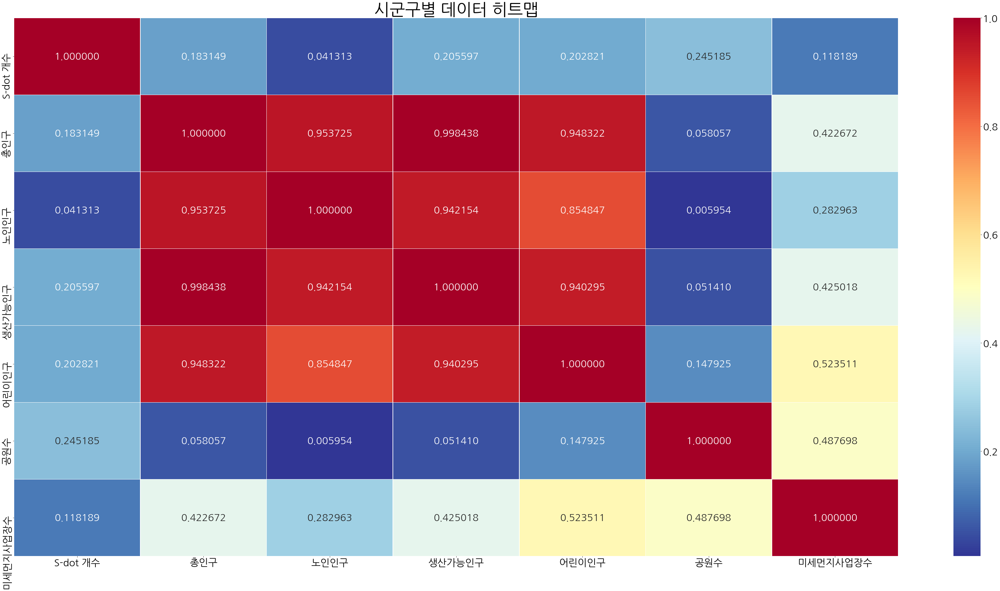

In [ ]:
# 히트맵 상관관계

plt.rcParams['figure.figsize'] = [60, 30]
plt.rcParams['font.family'] = 'NanumGothic'
plt.rcParams['font.size'] = 30
correlations = umd_total.corr() # plt.figure(figsize = (14, 12)) # Heatmap of correlations  
sns.heatmap(correlations, cmap = plt.cm.RdYlBu_r,annot=True,fmt="f",annot_kws={"size": 30},linewidths=.5)
plt.title('시군구별 데이터 히트맵',fontsize=50);

###### => 현재 S-dot의 설치수는  거주인구수 (일반 + 생산가능 + 복지필요)와 공원수, 미세먼지사업장와는 관계가 없다.

###### 단, 각 시군구에 거주중인 총인구수, 노인인구수, 생산가능인구수, 어린이인구수에는 아주 밀접한 관련이 있다. 즉, 인구가 많이 사는 시군구에는 생산가능인구와 어린이, 노인도 많이 사는 것이다.

각 col별로 세세하게 살펴보겠다.

In [ ]:
# 1) S-dot 개수별 정렬
umd_total.sort_values(by=['S-dot 개수'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
14,양천구,A034 | A058 | A059 | A064 | A109 | A111 | A112...,83,438788.0,68879.0,320483.0,49123.0,5,54
20,관악구,A028 | A173 | A189 | B0260 | B0262 | B0269 | B...,72,478030.0,81073.0,365754.0,30536.0,2,60
3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0,5,83
13,마포구,A096 | B0285 | B0288 | B0426 | B0439 | B0442 |...,70,356858.0,55551.0,266425.0,34035.0,5,63
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
0,종로구,A013 | A037 | A038 | A039 | A040 | A153 | A154...,52,140488.0,28360.0,100694.0,9710.0,12,72
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
9,도봉구,A030 | A048 | A049 | A050 | A051 | A052 | A053...,44,316467.0,65049.0,223912.0,27014.0,6,58
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141


In [ ]:
# 시군구별 S-dot수 시각화

center = [37.541, 126.986] #서울 중심
m11= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')

m11.choropleth(
 geo_data=df13,
 name='시군구별 S-dot',
 data=umd_total,
 columns=['시군구', 'S-dot 개수'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='S-dot 개수'
)

folium.LayerControl().add_to(m11)
 
for i in range(len(df1)):
    folium.Circle(
        location=[df1.iloc[i]['lat'], df1.iloc[i]['lon']],
        radius = 300, #반경 300m
        color = '#000000',
        fill = 'crimson',
    ).add_to(m11)
    
m11


In [ ]:
# 2) 총인구수별 정렬
umd_total.sort_values(by=['총인구'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
10,노원구,A144 | A160 | A206 | A213 | B0075 | B0076 | B0...,35,516002.0,91190.0,373226.0,50922.0,1,33
20,관악구,A028 | A173 | A189 | B0260 | B0262 | B0269 | B...,72,478030.0,81073.0,365754.0,30536.0,2,60
11,은평구,A035 | A036 | A069 | A152 | A168 | A204 | A209...,28,470837.0,89479.0,337841.0,42898.0,6,79
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
14,양천구,A034 | A058 | A059 | A064 | A109 | A111 | A112...,83,438788.0,68879.0,320483.0,49123.0,5,54
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46
21,서초구,A054 | A055 | A056 | A075 | A076 | A077 | A078...,37,415250.0,63122.0,300313.0,50374.0,5,156


In [ ]:
# 시군구별 총인구수 시각화
center = [37.541, 126.986] #서울 중심
m12= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')

m12.choropleth(
 geo_data=df13,
 name='시군구별 총 인구수',
 data=umd_total,
 columns=['시군구', '총인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='총 인구수'
)

folium.LayerControl().add_to(m12)
 
    
m12

In [ ]:
# 3) 노인인구수별 정렬
umd_total.sort_values(by=['노인인구'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
10,노원구,A144 | A160 | A206 | A213 | B0075 | B0076 | B0...,35,516002.0,91190.0,373226.0,50922.0,1,33
11,은평구,A035 | A036 | A069 | A152 | A168 | A204 | A209...,28,470837.0,89479.0,337841.0,42898.0,6,79
20,관악구,A028 | A173 | A189 | B0260 | B0262 | B0269 | B...,72,478030.0,81073.0,365754.0,30536.0,2,60
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
6,중랑구,A169 | A202 | A203 | B0159 | B0172 | B0191 | B...,26,391650.0,74806.0,284158.0,32221.0,6,77
16,구로구,A159 | A191 | A192 | A193 | B0043 | B0044 | B0...,30,385488.0,71643.0,275558.0,37645.0,4,108


In [ ]:
# 시군구별 노인인구수 시각화
center = [37.541, 126.986] #서울 중심
m13= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')

m13.choropleth(
 geo_data=df13,
 name='시군구별 노인인구수',
 data=umd_total,
 columns=['시군구', '노인인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='노인인구수'
)

folium.LayerControl().add_to(m13)
 
    
m13

In [ ]:
# 4) 생산가능인구수별 정렬
umd_total.sort_values(by=['생산가능인구'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
10,노원구,A144 | A160 | A206 | A213 | B0075 | B0076 | B0...,35,516002.0,91190.0,373226.0,50922.0,1,33
20,관악구,A028 | A173 | A189 | B0260 | B0262 | B0269 | B...,72,478030.0,81073.0,365754.0,30536.0,2,60
11,은평구,A035 | A036 | A069 | A152 | A168 | A204 | A209...,28,470837.0,89479.0,337841.0,42898.0,6,79
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
14,양천구,A034 | A058 | A059 | A064 | A109 | A111 | A112...,83,438788.0,68879.0,320483.0,49123.0,5,54
21,서초구,A054 | A055 | A056 | A075 | A076 | A077 | A078...,37,415250.0,63122.0,300313.0,50374.0,5,156
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46


In [ ]:
# 시군구별 생산가능인구수 시각화
center = [37.541, 126.986] #서울 중심
m14= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')

m14.choropleth(
 geo_data=df13,
 name='시군구별 생산가능인구수',
 data=umd_total,
 columns=['시군구', '생산가능인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='생산가능인구수'
)

folium.LayerControl().add_to(m14)
 
    
m14

In [ ]:
# 5) 어린이인구수별 정렬
umd_total.sort_values(by=['어린이인구'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
10,노원구,A144 | A160 | A206 | A213 | B0075 | B0076 | B0...,35,516002.0,91190.0,373226.0,50922.0,1,33
21,서초구,A054 | A055 | A056 | A075 | A076 | A077 | A078...,37,415250.0,63122.0,300313.0,50374.0,5,156
14,양천구,A034 | A058 | A059 | A064 | A109 | A111 | A112...,83,438788.0,68879.0,320483.0,49123.0,5,54
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
11,은평구,A035 | A036 | A069 | A152 | A168 | A204 | A209...,28,470837.0,89479.0,337841.0,42898.0,6,79
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46
16,구로구,A159 | A191 | A192 | A193 | B0043 | B0044 | B0...,30,385488.0,71643.0,275558.0,37645.0,4,108


In [ ]:
# 시군구별 어린이인구수 시각화
center = [37.541, 126.986] #서울 중심
m15= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')

m15.choropleth(
 geo_data=df13,
 name='시군구별 어린이인구수',
 data=umd_total,
 columns=['시군구', '어린이인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='어린이인구수'
)

folium.LayerControl().add_to(m15)
 
    
m15

In [ ]:
# 6) 공원수별 정렬
umd_total.sort_values(by=['공원수'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
0,종로구,A013 | A037 | A038 | A039 | A040 | A153 | A154...,52,140488.0,28360.0,100694.0,9710.0,12,72
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
9,도봉구,A030 | A048 | A049 | A050 | A051 | A052 | A053...,44,316467.0,65049.0,223912.0,27014.0,6,58
19,동작구,A068 | A073 | A116 | A118 | A119 | A120 | B019...,34,374036.0,67455.0,273510.0,32519.0,6,56
11,은평구,A035 | A036 | A069 | A152 | A168 | A204 | A209...,28,470837.0,89479.0,337841.0,42898.0,6,79
6,중랑구,A169 | A202 | A203 | B0159 | B0172 | B0191 | B...,26,391650.0,74806.0,284158.0,32221.0,6,77
3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0,5,83


In [ ]:
# 시군구별 공원수 시각화
center = [37.541, 126.986] #서울 중심
m16= folium.Map(location=center, zoom_start=16,tiles='cartodbpositron')

m16.choropleth(
 geo_data=df13,
 name='시군구별 공원수',
 data=umd_total,
 columns=['시군구', '공원수'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='PuRd',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='공원수'
)

folium.LayerControl().add_to(m16)

for i in range(len(df27)):
    folium.Circle(
        location=[df27.iloc[i]['lat'], df27.iloc[i]['lon']],
        radius = 70,
        color = '#000000',
        fill = 'crimson',
    ).add_to(m16)
 
    
m16

In [ ]:
# 7) 미세먼지사업장수별 정렬
umd_total.sort_values(by=['미세먼지사업장수'], axis=0, ascending=False)

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
22,강남구,A015 | A016 | A020 | A021 | A022 | A023 | A024...,50,535670.0,80046.0,395761.0,58063.0,7,249
15,강서구,A025 | A026 | A027 | A045 | A046 | A067 | A082...,52,568555.0,94502.0,418140.0,55123.0,9,207
21,서초구,A054 | A055 | A056 | A075 | A076 | A077 | A078...,37,415250.0,63122.0,300313.0,50374.0,5,156
24,강동구,A017 | A060 | A062 | A070 | A071 | A072 | A074...,64,452660.0,74984.0,328154.0,48995.0,7,146
23,송파구,A033 | A165 | A207 | A208 | B0117 | B0513 | B0...,42,661643.0,100764.0,488009.0,72218.0,7,141
17,금천구,A057 | B0220 | B0247 | B0369 | B0374 | B0405 |...,24,224547.0,41010.0,165752.0,17384.0,4,118
18,영등포구,A167 | A174 | B0074 | B0077 | B0110 | B0121 | ...,34,367076.0,63920.0,269465.0,32800.0,5,110
16,구로구,A159 | A191 | A192 | A193 | B0043 | B0044 | B0...,30,385488.0,71643.0,275558.0,37645.0,4,108
1,중구,A014 | A041 | A042 | A043 | A044 | A047 | A127...,40,110685.0,23096.0,79026.0,7841.0,4,90
3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0,5,83


In [ ]:
# 시군구별 미세먼지사업장수 시각화
center = [37.541, 126.986] #서울 중심
m17= folium.Map(location=center, zoom_start=15,tiles='cartodbpositron')

m17.choropleth(
 geo_data=df13,
 name='시군구별 미세먼지사업장수',
 data=umd_total,
 columns=['시군구', '미세먼지사업장수'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='미세먼지사업장수'
)

folium.LayerControl().add_to(m17)

for i in range(len(df7)):
    folium.Circle(
        location=[df7.iloc[i]['lat'], df7.iloc[i]['lon']],
        radius = 30,
        color = '#000000',
        fill = 'crimson',
    ).add_to(m17)
    
m17

# 2.4 시군구별 상세비교 

###### 1) 시군구별 총인구 vs 시군구별 생산가능인구

In [ ]:
from folium.features import DivIcon

center = [37.541, 126.986] #서울 중심
m18= folium.plugins.DualMap(location=center, zoom_start=10,tiles='cartodbpositron')

text1="총인구수"
text2="생산가능인구수"
text_lat, text_lng=34,130

choropleth1=folium.Choropleth(
geo_data=df13,
 name='시군구별 총 인구수',
 data=umd_total,
 columns=['시군구', '총인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='총 인구수'
).add_to(m18.m1)
folium.map.Marker([text_lat+0.5, text_lng-1.6], icon=DivIcon(icon_size=(150,36), icon_anchor=(0,0), html=text1)).add_to(m18.m1)

choropleth2=folium.Choropleth(
 geo_data=df13,
 name='시군구별 생산가능인구수',
 data=umd_total,
 columns=['시군구', '생산가능인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='생산가능인구수'
).add_to(m18.m2)
folium.map.Marker([text_lat+0.5, text_lng-1.6], icon=DivIcon(icon_size=(150,36), icon_anchor=(0,0), html=text2)).add_to(m18.m2)

folium.LayerControl().add_to(m18)

m18

=> 두 데이터가 거의 유사한 것이 확인된다.

###### 2) 시군구별 노인인구수 vs 시군구별 어린이인구수 (복지관련)

In [ ]:
center = [37.541, 126.986] #서울 중심
m19= folium.plugins.DualMap(location=center, zoom_start=10,tiles='cartodbpositron')

text3="노인인구수"
text4="어린이인구수"
text_lat, text_lng=34,130

choropleth3=folium.Choropleth(
 geo_data=df13,
 name='시군구별 노인인구수',
 data=umd_total,
 columns=['시군구', '노인인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='노인인구수'
).add_to(m19.m1)
folium.map.Marker([text_lat+0.5, text_lng-1.6], icon=DivIcon(icon_size=(150,36), icon_anchor=(0,0), html=text3)).add_to(m19.m1)

choropleth4=folium.Choropleth(
 geo_data=df13,
 name='시군구별 어린이인구수',
 data=umd_total,
 columns=['시군구', '어린이인구'],
 key_on='feature.properties.SIG_KOR_NM',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.5,
 legend_name='어린이인구수'
).add_to(m19.m2)
folium.map.Marker([text_lat+0.5, text_lng-1.6], icon=DivIcon(icon_size=(150,36), icon_anchor=(0,0), html=text4)).add_to(m19.m2)

folium.LayerControl().add_to(m19)

m19


두 데이터의 경향이 거의 유사하고 정도의 차이가 있는 것으로 확인된다.

###### 3) 시군구별 총인구수 vs 센서수

In [ ]:
umd_total

,시군구,S-dot,S-dot 개수,총인구,노인인구,생산가능인구,어린이인구,공원수,미세먼지사업장수
0,종로구,A013 | A037 | A038 | A039 | A040 | A153 | A154...,52,140488.0,28360.0,100694.0,9710.0,12,72
1,중구,A014 | A041 | A042 | A043 | A044 | A047 | A127...,40,110685.0,23096.0,79026.0,7841.0,4,90
2,용산구,A019 | B0523 | B0524 | B0525 | B0559 | B0571 |...,25,219247.0,40267.0,160187.0,17829.0,3,53
3,성동구,A018 | A032 | A164 | A216 | A217 | A218 | B011...,72,276335.0,46455.0,203758.0,25526.0,5,83
4,광진구,A012 | A029 | A142 | A143 | A190 | B0134 | B02...,29,339836.0,53658.0,257175.0,28492.0,2,42
5,동대문구,A195 | A196 | A197 | B0049 | B0058 | B0081 | B...,25,332401.0,64918.0,238490.0,28158.0,4,79
6,중랑구,A169 | A202 | A203 | B0159 | B0172 | B0191 | B...,26,391650.0,74806.0,284158.0,32221.0,6,77
7,성북구,A198 | A199 | A200 | B0064 | B0087 | B0131 | B...,28,415695.0,75844.0,299341.0,39260.0,4,46
8,강북구,A066 | A100 | A104 | A129 | A130 | A132 | A133...,32,296281.0,65486.0,207867.0,22368.0,3,41
9,도봉구,A030 | A048 | A049 | A050 | A051 | A052 | A053...,44,316467.0,65049.0,223912.0,27014.0,6,58


In [ ]:
# 결론 : 회귀 분석을 사용하기에는 어려울 것 같다. 지금 S-dot 가 시군구별로 골고루 잘 설치되어 있는 것 같지는 않다.

# 추가해야 하는점. 면적 + 유동인구(지하철? 버스? 교통량? )도 같이 해보면 좋을듯


# 소음센서 : 1) 골고루 단다 -> 2) 주거 지역 우선으로 단다. 3) 복지층을 위한 곳에 단다.
# 오존센서: 

In [ ]:
# 소음센서

# 3) 오존 측정 가능 센서 (S-dot) 확인

df1_ozone=df1[df1['OZONE']=='O']
df1_ozone

df5

,date,loc,PM2.5,PM10,NO,NO2,NOx,CO,O3,SO2,WD,WS,TEMP,HUM
0,20200501,강남구,30,43,0.002,0.01,0.012,0.4,0.049,0.002,SSW,0.8,21,70
1,20200502,강남구,30,43,0.002,0.013,0.015,0.4,0.038,0.002,W,0.8,21,76
2,20200503,강남구,18,25,0.002,0.014,0.017,0.4,0.031,0.002,ENE,0.5,22.2,67
3,20200504,강남구,17,30,0.003,0.02,0.023,0.4,0.036,0.002,SE,0.9,21.1,60
4,20200505,강남구,21,34,0.005,0.028,0.033,0.5,0.021,0.003,SSW,0.7,16.9,64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9120,20210426,중랑구,12,25,0.004,0.016,0.02,0.3,0.039,0.003,WNW,1.2,16.6,43
9121,20210427,중랑구,14,30,0.006,0.026,0.031,0.4,0.031,0.003,NNW,0.9,16,55
9122,20210428,중랑구,26,77,0.007,0.027,0.034,0.5,0.025,0.003,NW,0.9,15.3,58
9123,20210429,중랑구,20,60,0.009,0.028,0.037,0.4,0.03,0.003,E,1.3,14.5,48


In [ ]:
#*을 모두 제외 
df5['NO'] = df5['NO'].apply(lambda x: float(x.split()[0].replace('*', ''))) #질소산화물1
df5['NO2'] = df5['NO2'].apply(lambda x: float(x.split()[0].replace('*', ''))) #질소산화물2
df5['NOx'] = df5['NOx'].apply(lambda x: float(x.split()[0].replace('*', '')))
df5['O3'] = df5['O3'].apply(lambda x: float(x.split()[0].replace('*', ''))) #오존
df5['PM2.5'] = df5['PM2.5'].apply(lambda x: float(x.split()[0].replace('*', '')))#미세먼지1
df5['PM10'] = df5['PM10'].apply(lambda x: float(x.split()[0].replace('*', '')))#미세먼지2
df5['CO'] = df5['CO'].apply(lambda x: float(x.split()[0].replace('*', '')))
df5['SO2'] = df5['SO2'].apply(lambda x: float(x.split()[0].replace('*', '')))


In [ ]:
df5['NO']=pd.to_numeric(df5['NO'])
df5['NO2']=pd.to_numeric(df5['NO2'])
df5['NOx']=pd.to_numeric(df5['NOx'])
df5['O3']=pd.to_numeric(df5['O3'])
df5['PM2.5']=pd.to_numeric(df5['PM2.5'])
df5['PM10']=pd.to_numeric(df5['PM10'])
df5['CO']=pd.to_numeric(df5['CO'])
df5['SO2']=pd.to_numeric(df5['SO2'])

In [ ]:
merge_df3

,date,loc,PM2.5,PM10,NO,NO2,NOx,CO,O3,SO2,WD,WS,TEMP,HUM,serial_no,set_h,lat,lon
0,20200501,강남구,30.0,43.0,0.002,0.010,0.012,0.4,0.049,0.002,SSW,0.8,21,70,B0789,0.5,37.517552,127.047995
1,20200502,강남구,30.0,43.0,0.002,0.013,0.015,0.4,0.038,0.002,W,0.8,21,76,B0789,0.5,37.517552,127.047995
2,20200503,강남구,18.0,25.0,0.002,0.014,0.017,0.4,0.031,0.002,ENE,0.5,22.2,67,B0789,0.5,37.517552,127.047995
3,20200504,강남구,17.0,30.0,0.003,0.020,0.023,0.4,0.036,0.002,SE,0.9,21.1,60,B0789,0.5,37.517552,127.047995
4,20200505,강남구,21.0,34.0,0.005,0.028,0.033,0.5,0.021,0.003,SSW,0.7,16.9,64,B0789,0.5,37.517552,127.047995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9120,20210426,중랑구,12.0,25.0,0.004,0.016,0.020,0.3,0.039,0.003,WNW,1.2,16.6,43,B0882,1.0,37.584899,127.094026
9121,20210427,중랑구,14.0,30.0,0.006,0.026,0.031,0.4,0.031,0.003,NNW,0.9,16,55,B0882,1.0,37.584899,127.094026
9122,20210428,중랑구,26.0,77.0,0.007,0.027,0.034,0.5,0.025,0.003,NW,0.9,15.3,58,B0882,1.0,37.584899,127.094026
9123,20210429,중랑구,20.0,60.0,0.009,0.028,0.037,0.4,0.030,0.003,E,1.3,14.5,48,B0882,1.0,37.584899,127.094026


In [ ]:
pd.set_option('display.max_rows', 10)
merge_df3["PM2.5"].value_counts()
merge_df3["PM10"].value_counts()
merge_df3["NO"].value_counts()

0.003    1500
0.002    1165
0.004    1135
0.005     819
0.006     579
         ... 
0.088       1
0.087       1
0.083       1
0.120       1
0.102       1
Name: NO, Length: 95, dtype: int64

In [ ]:
#선행연구 : O3과 PM2.5의 계절별 상관관계를 연구하였다. O3과 PM2.5는 여름철(6,7, 8월)에 평균 0.66의 높은 상관계수를 나타냈으며,
#겨울철(1, 2, 12월)에는 이와 반대로 평균 -0.37의 음의 상관계수를 나타내었다.

# . NO의 경우 아침 출근시간대인 오전 6시에서 오전 10시 사이에 가장 높은농도가 관측되었고, O3 농도가 낮을수록 NO 농도는 높게 관측되었다. NO2의 경우 아침 출근 시간대와 야간에 높은 농도를 나타내었다. O3의 경우 오후 1시에서 4시 사이에 가장 높은 농도를 나타내는 일변화 경향을보였으며, 이는 도심환경에서 광화학 오존생성과정의특성에 따른 일반적으로 나타나는 경향으로 사료된다
# O3 농도의 일반적인 일 중 변화 특징을 살펴보면 한낮에 가장 높고 밤 시간대에 낮은 변화 경향이 전체 측정기간 동안 뚜렷이 나타났으며, 측정기간 동안 대부분나타난 하루 중 낮 동안의 가파른 오존농도 상승은 낮동안의 차량배출량 등으로 인한 NOx와 VOCs 증가와더불어 강한 태양자외선에 의한 오존의 광화학적 생성특성에 따른 것으로 보인다. 
# CO 농도변화에 따른 O3 농도변화 => 없다.
corr=merge_df3[['PM2.5','PM10','NO','NO2','NOx','CO','SO2']].corr()
#corr0=corr[["O3"]]
corr1=corr[['PM2.5','PM10','CO', 'NO','NO2','NOx','SO2']]
# 추가 연구 방법 : 시간대별, 계절, 월별로 구분해서 분석 => 피어슨, 공분산


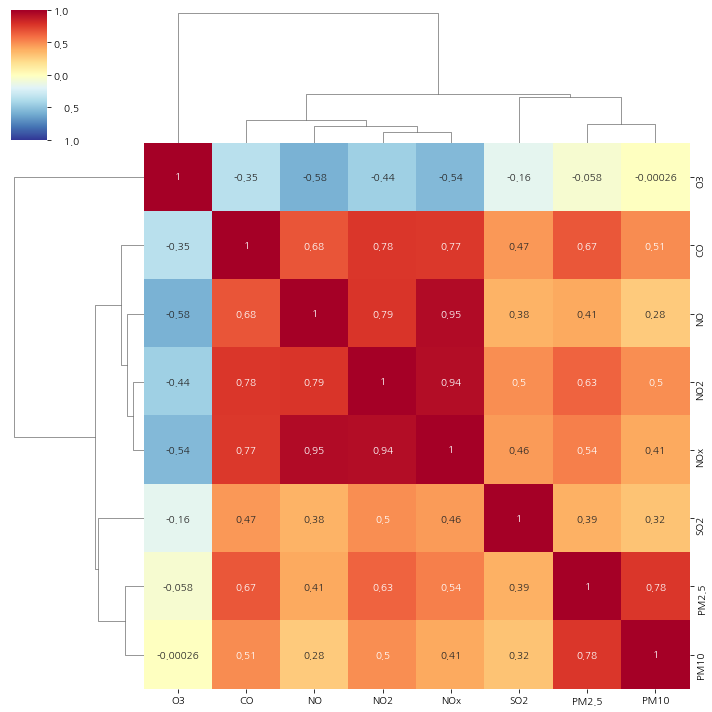

In [ ]:
plt.rcParams['font.size'] = 10
sns.clustermap(corr, 
               annot = True,      # 실제 값 화면에 나타내기
               cmap = 'RdYlBu_r',  # Red, Yellow, Blue 색상으로 표시
               vmin = -1, vmax = 1, #컬러차트 -1 ~ 1 범위로 표시
              )

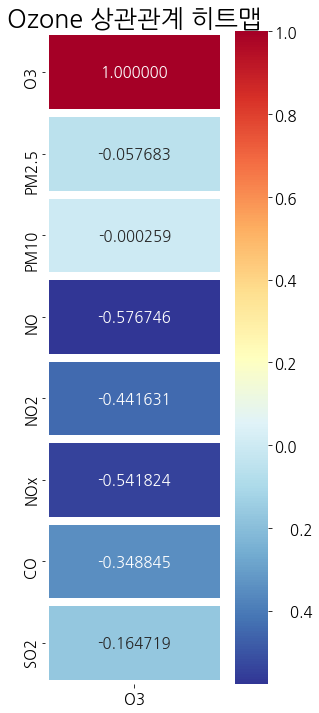

In [ ]:
plt.rcParams['figure.figsize'] = [60, 30]
plt.rcParams['font.family'] = 'NanumGothic'
plt.rcParams['font.size'] = 15
correlations =corr0 
plt.figure(figsize = (4, 12)) # Heatmap of correlations  
sns.heatmap(correlations, cmap = plt.cm.RdYlBu_r,annot=True,fmt="f",annot_kws={"size": 15},linewidths=7)
plt.title('Ozone 상관관계 히트맵',fontsize=25);

Text(0.5, 1.0, '대기오염물질 상관관계 히트맵')

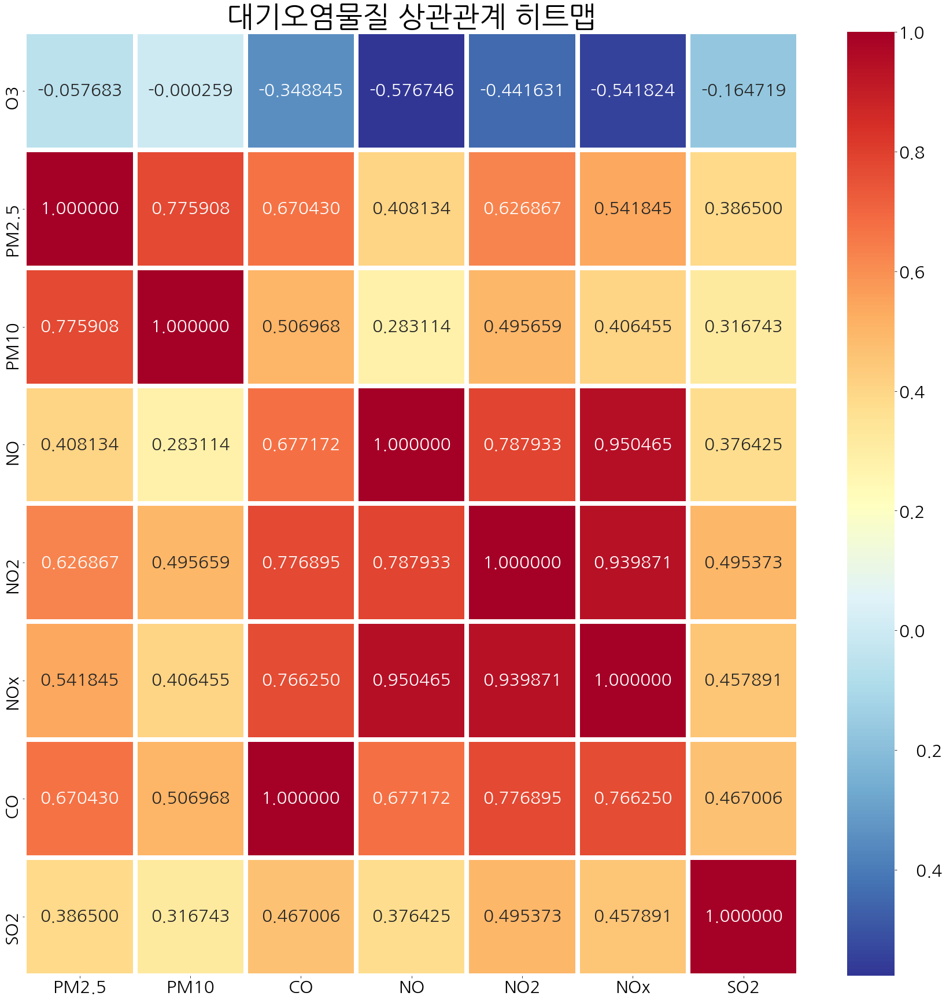

In [ ]:
plt.rcParams['figure.figsize'] = [60, 30]
plt.rcParams['font.family'] = 'NanumGothic'
plt.rcParams['font.size'] = 30
correlations =corr1
plt.figure(figsize = (30, 30)) # Heatmap of correlations  
sns.heatmap(correlations, cmap = plt.cm.RdYlBu_r,annot=True,fmt="f",annot_kws={"size": 30},linewidths=7)
plt.title('대기오염물질 상관관계 히트맵',fontsize=50)

In [ ]:
#기본 merge형태 (df5+df6)
group2=df5.groupby(df5['loc']).mean()
merge_df4 = pd.merge(group2, df6,on='loc',how='left')
merge_df4

,loc,date,PM2.5,PM10,NO,NO2,NOx,CO,O3,SO2,serial_no,set_h,lat,lon
0,강남구,2.020396e+07,21.482192,34.230137,0.009789,0.025019,0.034789,0.484384,0.025532,0.003153,B0789,0.5,37.517552,127.047995
1,강동구,2.020396e+07,22.621918,38.769863,0.012170,0.024290,0.036419,0.447123,0.022882,0.002726,B0798,2.9,37.545038,127.136812
2,강북구,2.020396e+07,20.638356,39.717808,0.006679,0.016808,0.023460,0.437808,0.024742,0.002729,B0712,2.0,37.647923,127.011898
3,강서구,2.020396e+07,21.438356,39.183562,0.010795,0.024364,0.035126,0.437808,0.026345,0.003918,B0782,4.2,37.544678,126.835104
4,관악구,2.020396e+07,18.695890,35.172603,0.011290,0.028184,0.039414,0.508767,0.024192,0.003140,B0884,1.0,37.487397,126.927124
5,광진구,2.020396e+07,20.210959,35.024658,0.008537,0.019995,0.028466,0.526027,0.023989,0.002910,B0779,3.7,37.544959,127.094305
6,구로구,2.020396e+07,20.076712,38.813699,0.010216,0.021893,0.032110,0.353151,0.027485,0.003123,B0751,1.0,37.498489,126.889502
7,금천구,2.020396e+07,22.312329,37.736986,0.011753,0.025271,0.036992,0.476438,0.023882,0.002951,B0880,1.2,37.452375,126.908304
8,노원구,2.020396e+07,20.961644,36.345205,0.010841,0.022638,0.033422,0.493973,0.027932,0.002995,B0755,0.8,37.658856,127.068501
9,도봉구,2.020396e+07,19.471233,33.232877,0.006847,0.018008,0.024800,0.354795,0.029068,0.002756,B0752,0.4,37.654166,127.029228


In [ ]:
df37_noise=df37[df37['cen_noise']=='○']

for i in range(len(df37_noise)):
    folium.Circle(
        location=[df37_noise.iloc[i]['lat'], df37_noise.iloc[i]['lon']],
        radius = 300, #반경 300m
        color = 'rad',
        fill = 'crimson',
    ).add_to(m11)
    
m11


In [ ]:
df38

,center_nm,serial,censor_pm10,censor_pm25,cen_noise,cen_hu,cen_temp,tm_reg,note
0,강남구,GN18925,10.0,16,52,46.3,-6.5,2021-01-01 0:00,NaN
1,강남구,GN18933,10.0,16,52.3,47.8,-6.8,2021-01-01 0:00,NaN
2,강남구,GN18941,10.0,17,65.9,45,-6.1,2021-01-01 0:00,NaN
3,강남구,GN18958,13.0,20,59.1,43.3,-5.7,2021-01-01 0:00,NaN
4,강남구,GN18966,9.0,19,66.4,47.7,-6.7,2021-01-01 0:00,NaN
...,...,...,...,...,...,...,...,...,...
479316,구로구,GR201,25.4,-,-,-,-,2021.07.12. 14:32,고척2동주민센터
479317,구로구,GR201,18.0,-,-,-,-,2021.07.12. 14:32,개봉1동주민센터
479318,구로구,GR201,17.1,-,-,-,-,2021.07.12. 14:32,개봉3동주민센터
479319,구로구,GR201,14.0,-,-,-,-,2021.07.12. 14:32,오류2동주민센터
